##Proyecto detección de Alzheimer (Primeras etapas)

####Integrantes
*   Santiago Ospina Fajardo
*   David Felipe Bermudez
*   Laura Melissa Vargas


In [ ]:
!pip install SimpleITK

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.6/52.6 MB 13.2 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


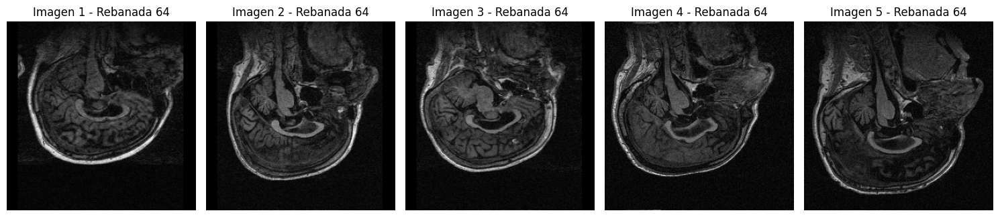

In [ ]:
import SimpleITK as sitk
import matplotlib.pyplot as plt
import numpy as np

# Rutas a las imágenes NIfTI (.hdr o .img)
nifti_paths = [
    '/content/drive/MyDrive/Pacientes P.E/OAS2_0007_MR3/RAW/mpr-3.nifti.hdr',
    '/content/drive/MyDrive/Pacientes P.E/OAS2_0012_MR3/RAW/mpr-3.nifti.hdr',
    '/content/drive/MyDrive/Pacientes P.E/OAS2_0013_MR3/RAW/mpr-1.nifti.hdr',
    '/content/drive/MyDrive/Pacientes P.E/OAS2_0037_MR4/RAW/mpr-3.nifti.hdr',
    '/content/drive/MyDrive/Pacientes P.E/OAS2_0048_MR5/RAW/mpr-3.nifti.hdr'
]

# Cargar imágenes NIfTI
images = [sitk.GetArrayFromImage(sitk.ReadImage(path)) for path in nifti_paths]

# Configurar la visualización en una sola fila
fig, axes = plt.subplots(1, len(images), figsize=(15, 5))

for i, (image_array, ax) in enumerate(zip(images, axes)):
    ax.imshow(image_array[63, :, :], cmap='gray')
    ax.set_title(f'Imagen {i + 1} - Rebanada 64')
    ax.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
# Guardar cada imagen procesada
for i, image_array in enumerate(images):
    plt.imshow(image_array[63, :, :], cmap='gray')
    plt.axis('off')  # Quitar ejes
    filename = f'/content/corte_64_imagen_{i + 1}.png'
    plt.savefig(filename, bbox_inches='tight', pad_inches=0)
    print(f'Imagen guardada en: {filename}')
    plt.close()

Imagen guardada en: /content/corte_64_imagen_1.png
Imagen guardada en: /content/corte_64_imagen_2.png
Imagen guardada en: /content/corte_64_imagen_3.png
Imagen guardada en: /content/corte_64_imagen_4.png
Imagen guardada en: /content/corte_64_imagen_5.png


Imagen rotada guardada en: /content/corte_64_rotado_5.png
Imagen rotada guardada en: /content/corte_64_rotado_1.png
Imagen rotada guardada en: /content/corte_64_rotado_2.png
Imagen rotada guardada en: /content/corte_64_rotado_4.png
Imagen rotada guardada en: /content/corte_64_rotado_3.png


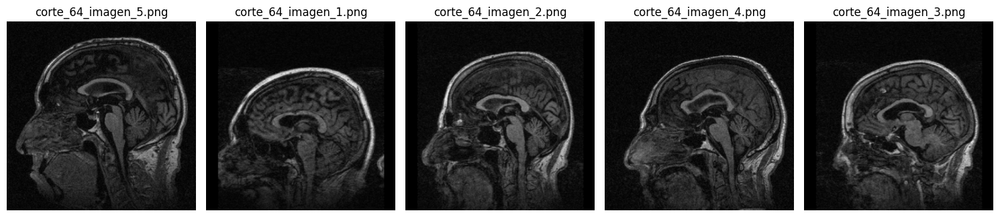

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt
import glob  # Para buscar múltiples archivos con un patrón

# Ruta del patrón para cargar todas las imágenes guardadas
image_paths = glob.glob('/content/corte_64_imagen_*.png')

# Rotar y guardar cada imagen procesada
rotated_images = []  # Para almacenar imágenes rotadas para mostrar después
for path in image_paths:
    image = Image.open(path)
    rotated_image = image.rotate(180)

    # Generar el nuevo nombre para la imagen rotada
    rotated_path = path.replace("corte_64_imagen_", "corte_64_rotado_")
    rotated_image.save(rotated_path)

    rotated_images.append(rotated_image)
    print(f'Imagen rotada guardada en: {rotated_path}')

# Mostrar todas las imágenes rotadas en una fila
fig, axes = plt.subplots(1, len(rotated_images), figsize=(15, 5))

for ax, img, path in zip(axes, rotated_images, image_paths):
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(f'{path.split("/")[-1]}')

plt.tight_layout()
plt.show()


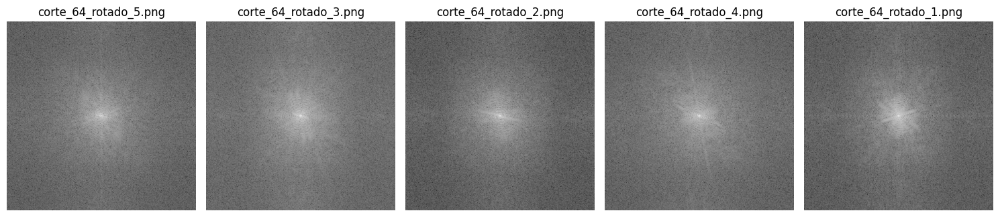

In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import glob

# Ruta de las imágenes rotadas
rotated_image_paths = glob.glob('/content/corte_64_rotado_*.png')

espectros = []  # Lista para almacenar los espectros

# Procesar cada imagen rotada
for path in rotated_image_paths:
    imagen = Image.open(path)

    # Convertir la imagen a un array numpy
    array = np.array(imagen)
    if array.ndim == 3 and array.shape[2] >= 3:
        # Convertir a escala de grises si la imagen es RGB
        arrayGris = np.dot(array[..., :3], [0.2989, 0.5870, 0.1140]).astype(np.uint8)
    else:
        arrayGris = array

    # Cuantización para reducir los niveles de intensidad
    imagenGris = (arrayGris // 15) * 15

    # Aplicar la Transformada de Fourier 2D
    fourier = np.fft.fft2(imagenGris)
    # Shift para desplazar las frecuencias bajas al centro del espectro
    fourierShift = np.fft.fftshift(fourier)

    # Calcular el espectro de magnitudes
    espectro = np.log(np.abs(fourierShift) + 1)
    espectros.append(espectro)

# Mostrar todos los espectros en una sola fila
fig, axes = plt.subplots(1, len(espectros), figsize=(15, 5))

for ax, espectro, path in zip(axes, espectros, rotated_image_paths):
    ax.imshow(espectro, cmap='gray')
    ax.axis('off')
    ax.set_title(f'{path.split("/")[-1]}')

plt.tight_layout()
plt.show()


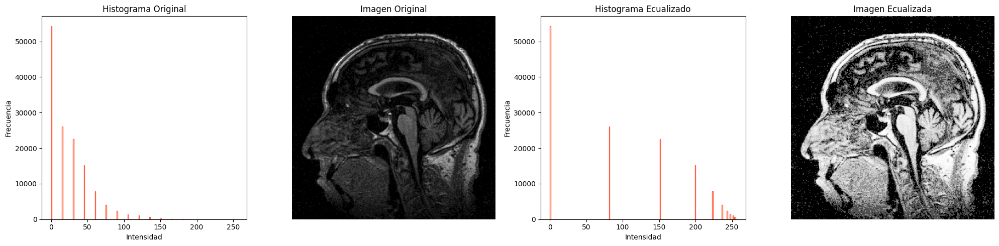

Imagen ecualizada guardada en: /content/corte_64_ecualizada_5.png


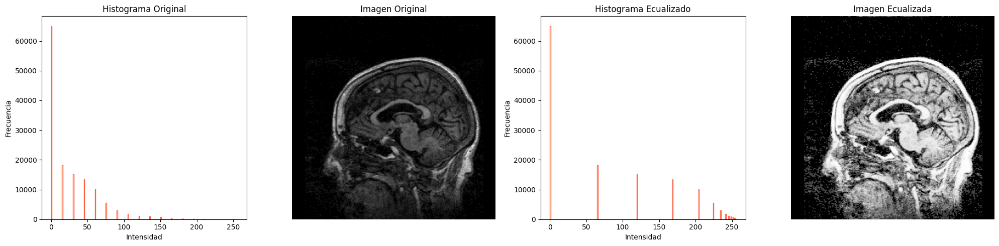

Imagen ecualizada guardada en: /content/corte_64_ecualizada_3.png


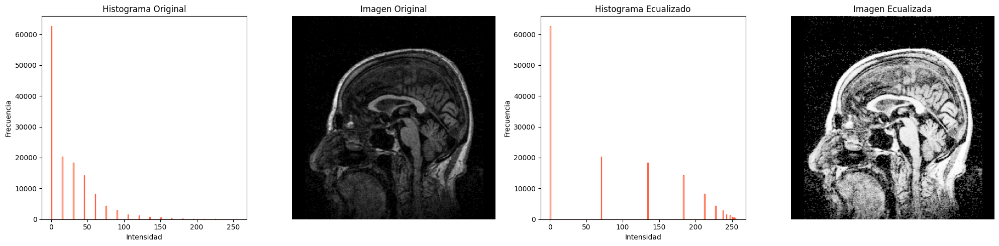

Imagen ecualizada guardada en: /content/corte_64_ecualizada_2.png


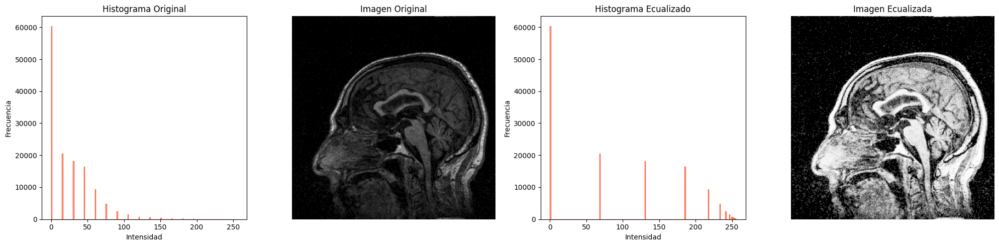

Imagen ecualizada guardada en: /content/corte_64_ecualizada_4.png


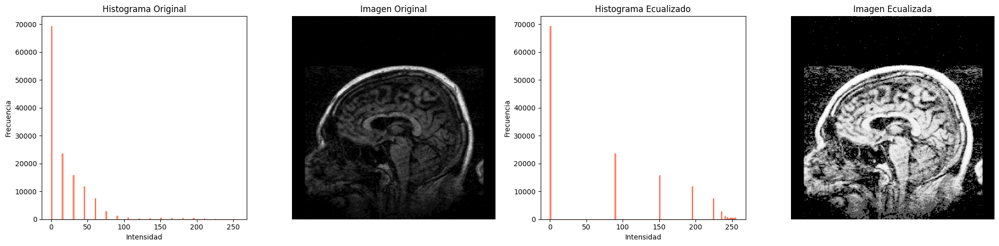

Imagen ecualizada guardada en: /content/corte_64_ecualizada_1.png


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import glob

# Ruta para cargar las imágenes rotadas
rotated_image_paths = glob.glob('/content/corte_64_rotado_*.png')

# Función para ecualización del histograma
def ecualizar_histograma(imagen):
    histograma, bins = np.histogram(imagen.flatten(), bins=256, range=[0,256])
    cdf = histograma.cumsum()
    cdf_normalizado = 255 * (cdf - cdf.min()) / (cdf.max() - cdf.min())
    imagen_ecualizada = np.interp(imagen.flatten(), bins[:-1], cdf_normalizado)
    return imagen_ecualizada.reshape(imagen.shape)

# Procesar cada imagen rotada
for path in rotated_image_paths:
    # Cargar y convertir la imagen a escala de grises
    imagen = Image.open(path)
    array = np.array(imagen)
    if array.ndim == 3 and array.shape[2] >= 3:
        arrayGris = np.dot(array[..., :3], [0.2989, 0.5870, 0.1140]).astype(np.uint8)
    else:
        arrayGris = array

    # Cuantización para reducir los niveles de intensidad
    imagenGris = (arrayGris // 15) * 15

    # Aplicar ecualización del histograma
    imagen_ecualizada = ecualizar_histograma(imagenGris)

    # Mostrar histogramas e imágenes
    fig, axes = plt.subplots(1, 4, figsize=(20, 5))

    # Histograma original
    axes[0].hist(imagenGris.ravel(), bins=256, range=(0, 256), color='peachpuff', edgecolor='tomato')
    axes[0].set_title('Histograma Original', fontsize=12)
    axes[0].set_xlabel('Intensidad')
    axes[0].set_ylabel('Frecuencia')

    # Imagen original
    axes[1].imshow(imagenGris, cmap='gray')
    axes[1].set_title('Imagen Original', fontsize=12)
    axes[1].axis('off')

    # Histograma ecualizado
    axes[2].hist(imagen_ecualizada.ravel(), bins=256, range=(0, 256), color='peachpuff', edgecolor='tomato')
    axes[2].set_title('Histograma Ecualizado', fontsize=12)
    axes[2].set_xlabel('Intensidad')
    axes[2].set_ylabel('Frecuencia')

    # Imagen ecualizada
    axes[3].imshow(imagen_ecualizada, cmap='gray')
    axes[3].set_title('Imagen Ecualizada', fontsize=12)
    axes[3].axis('off')

    plt.tight_layout()
    plt.show()

    # Guardar la imagen ecualizada
    imagen_ecualizada_uint8 = imagen_ecualizada.astype(np.uint8)
    imagen_pil = Image.fromarray(imagen_ecualizada_uint8)
    save_path = path.replace("corte_64_rotado_", "corte_64_ecualizada_")
    imagen_pil.save(save_path)

    print(f'Imagen ecualizada guardada en: {save_path}')



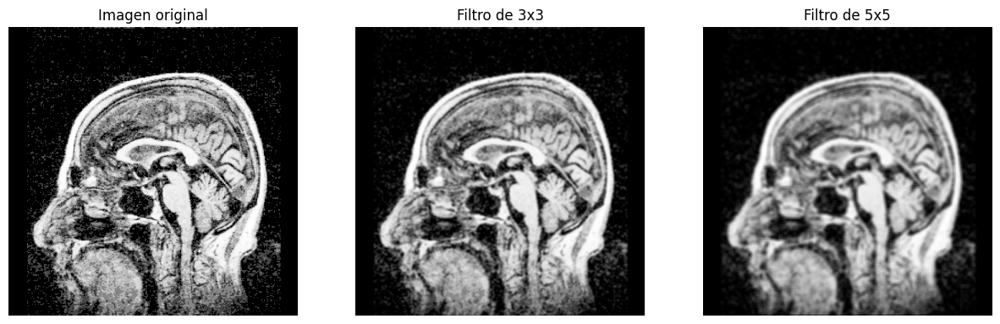

Imágenes filtradas guardadas: 
- /content/corte_64_filtrada_3x3_2.png


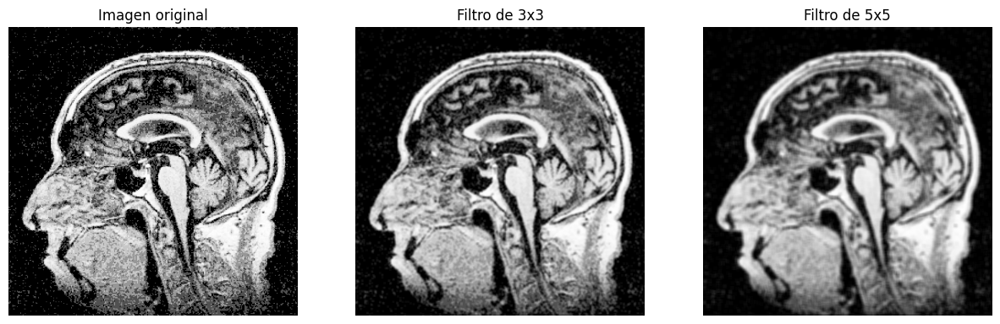

Imágenes filtradas guardadas: 
- /content/corte_64_filtrada_3x3_5.png


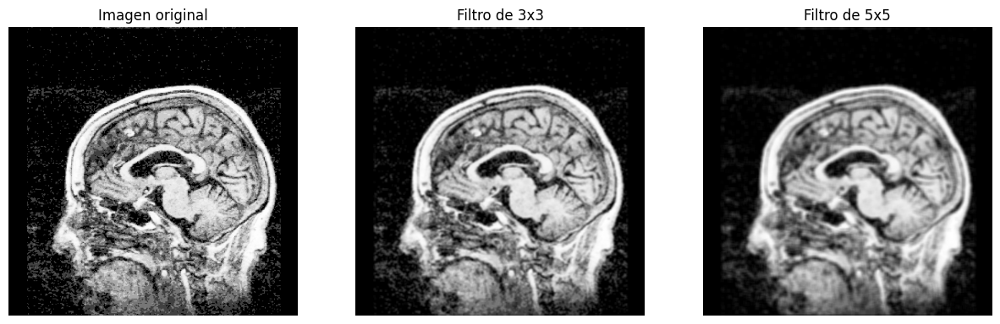

Imágenes filtradas guardadas: 
- /content/corte_64_filtrada_3x3_3.png


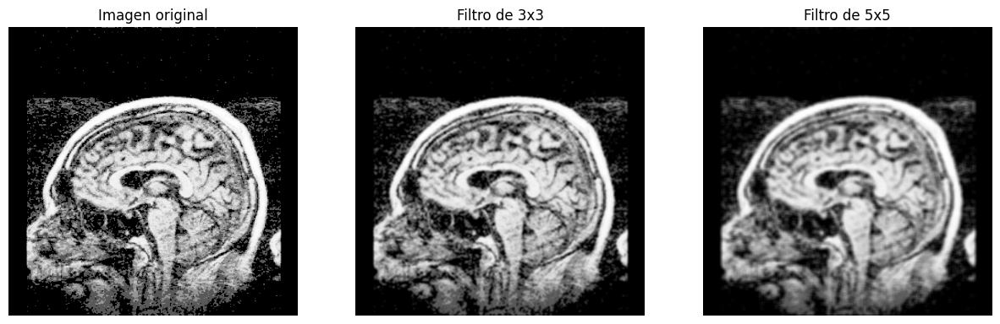

Imágenes filtradas guardadas: 
- /content/corte_64_filtrada_3x3_1.png


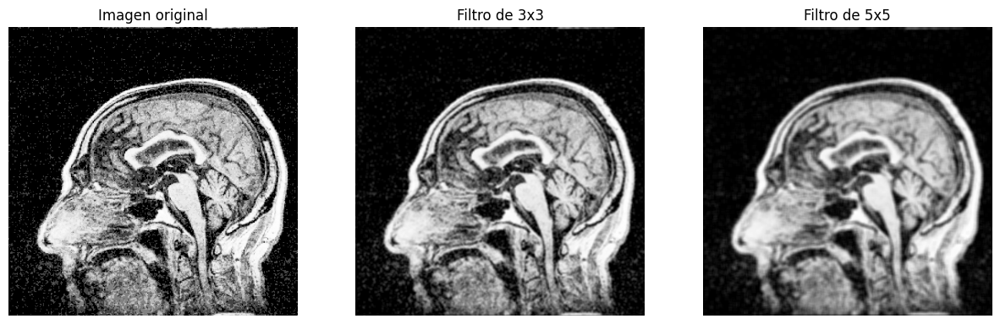

Imágenes filtradas guardadas: 
- /content/corte_64_filtrada_3x3_4.png


In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import glob

# Ruta de las imágenes ecualizadas
ecualized_image_paths = glob.glob('/content/corte_64_ecualizada_*.png')

# Función para aplicar la convolución
def convolucion(imagen, kernel):
    alto, ancho = imagen.shape
    kAlto, kAncho = kernel.shape
    paddingAlto, paddingAncho = kAlto // 2, kAncho // 2
    imagenPadded = np.pad(imagen, ((paddingAlto, paddingAlto), (paddingAncho, paddingAncho)), mode='constant')
    salida = np.zeros((alto, ancho))

    for i in range(alto):
        for j in range(ancho):
            region = imagenPadded[i:i + kAlto, j:j + kAncho]
            salida[i, j] = np.sum(region * kernel)

    return np.clip(salida, 0, 255).astype(np.uint8)

# Definición de los kernels
kernel3x3 = np.ones((3, 3)) / 9
kernel5x5 = np.ones((5, 5)) / 25

# Procesar cada imagen ecualizada
for path in ecualized_image_paths:
    imagen = Image.open(path)
    array = np.array(imagen)

    # Aplicar los filtros de convolución
    imagenFiltrada3x3 = convolucion(array, kernel3x3)
    imagenFiltrada5x5 = convolucion(array, kernel5x5)

    # Mostrar los resultados
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(array, cmap='gray')
    ax[0].set_title("Imagen original")
    ax[1].imshow(imagenFiltrada3x3, cmap='gray')
    ax[1].set_title("Filtro de 3x3")
    ax[2].imshow(imagenFiltrada5x5, cmap='gray')
    ax[2].set_title("Filtro de 5x5")

    for a in ax:
        a.axis('off')
    plt.show()

    # Guardar las imágenes filtradas
    path_3x3 = path.replace("ecualizada", "filtrada_3x3")

    Image.fromarray(imagenFiltrada3x3).save(path_3x3)

    print(f'Imágenes filtradas guardadas: \n- {path_3x3}')


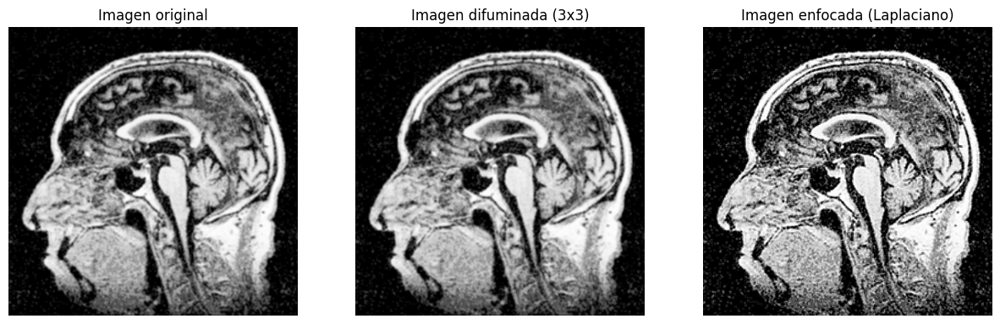

Imagen enfocada guardada: /content/corte_64_enfocada_laplaciano_5.png


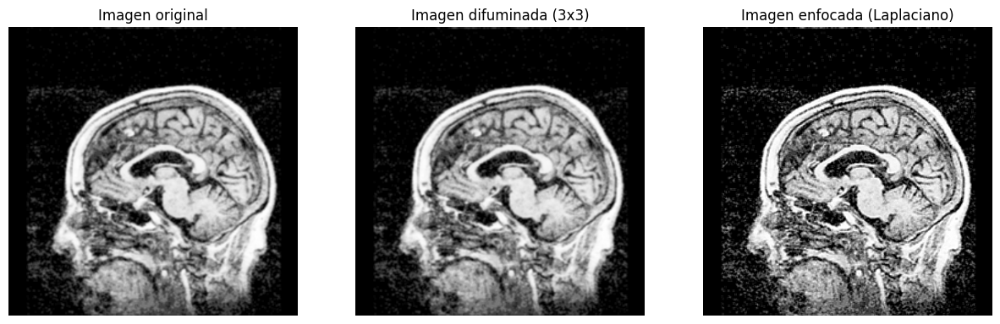

Imagen enfocada guardada: /content/corte_64_enfocada_laplaciano_3.png


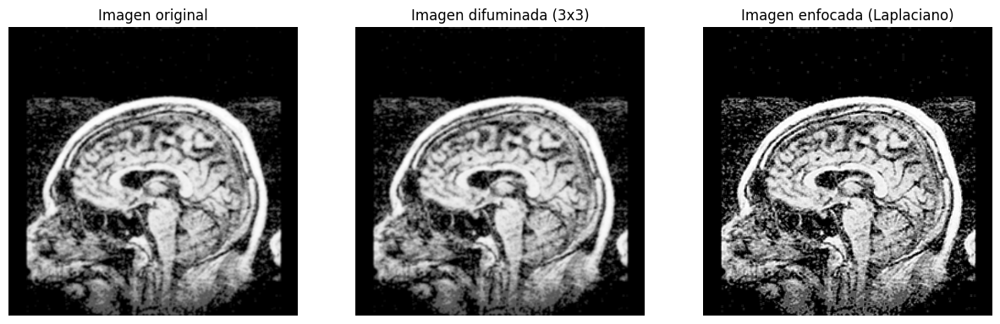

Imagen enfocada guardada: /content/corte_64_enfocada_laplaciano_1.png


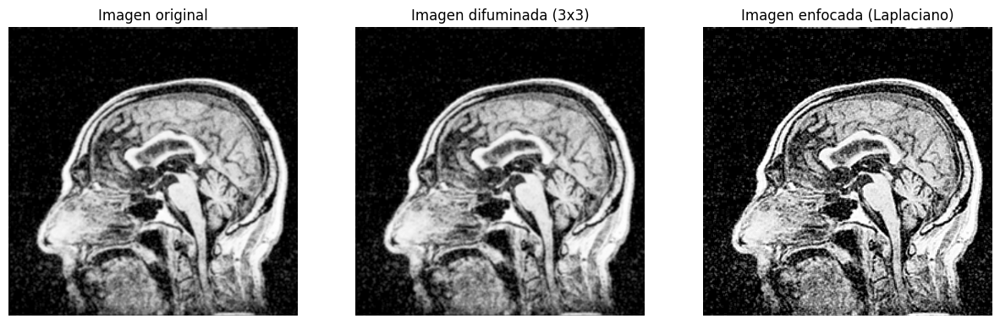

Imagen enfocada guardada: /content/corte_64_enfocada_laplaciano_4.png


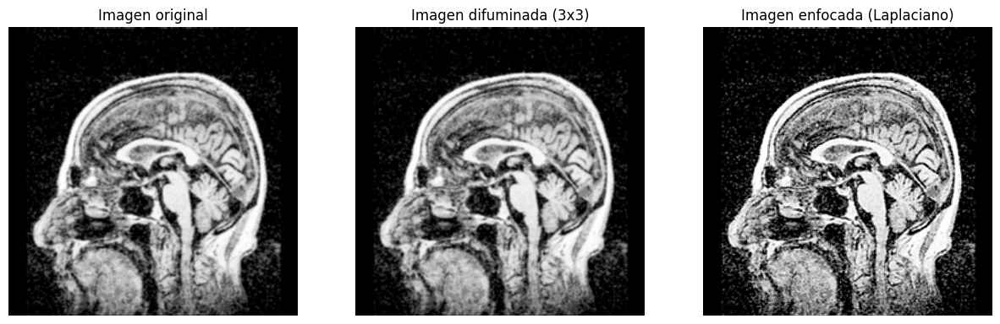

Imagen enfocada guardada: /content/corte_64_enfocada_laplaciano_2.png


In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import glob

# Ruta de las imágenes filtradas (de 3x3)
filtrada_3x3_image_paths = glob.glob('/content/corte_64_filtrada_3x3_*.png')

# Definir la máscara Laplaciana para el enfoque
kernelLaplaciano = np.array([[0, -1, 0],
                              [-1, 5, -1],
                              [0, -1, 0]])

# Función de convolución ya definida (usada para la aplicación de la máscara)
def convolucion(imagen, kernel):
    alto, ancho = imagen.shape
    kAlto, kAncho = kernel.shape
    paddingAlto, paddingAncho = kAlto // 2, kAncho // 2
    imagenPadded = np.pad(imagen, ((paddingAlto, paddingAlto), (paddingAncho, paddingAncho)), mode='constant')
    salida = np.zeros((alto, ancho))

    for i in range(alto):
        for j in range(ancho):
            region = imagenPadded[i:i + kAlto, j:j + kAncho]
            salida[i, j] = np.sum(region * kernel)

    return np.clip(salida, 0, 255).astype(np.uint8)

# Procesar cada imagen filtrada
for path in filtrada_3x3_image_paths:
    imagen = Image.open(path)
    array = np.array(imagen)

    # Aplicar el filtro de enfoque (Laplaciano)
    imagenEnfocada = convolucion(array, kernelLaplaciano)

    # Mostrar los resultados
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(array, cmap='gray')
    ax[0].set_title("Imagen original")
    ax[1].imshow(imagen, cmap='gray')
    ax[1].set_title("Imagen difuminada (3x3)")
    ax[2].imshow(imagenEnfocada, cmap='gray')
    ax[2].set_title("Imagen enfocada (Laplaciano)")

    for a in ax:
        a.axis('off')
    plt.show()

    # Guardar la imagen enfocada
    path_enfocada = path.replace("filtrada_3x3", "enfocada_laplaciano")
    Image.fromarray(imagenEnfocada).save(path_enfocada)

    print(f'Imagen enfocada guardada: {path_enfocada}')


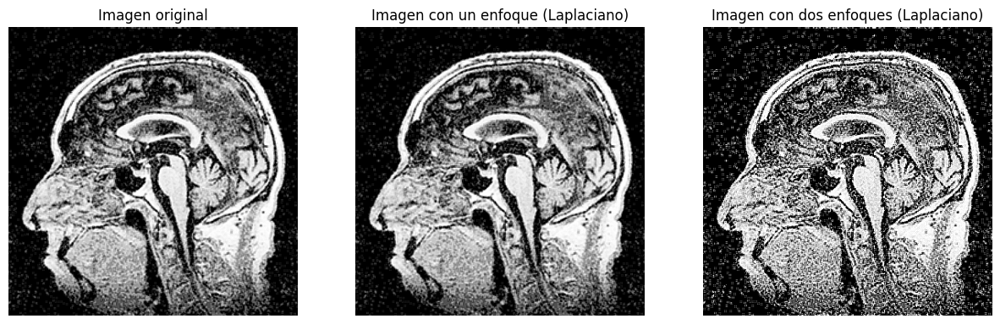

Imagen con dos enfoques guardada: /content/corte_64_doble_enfoque_5.png


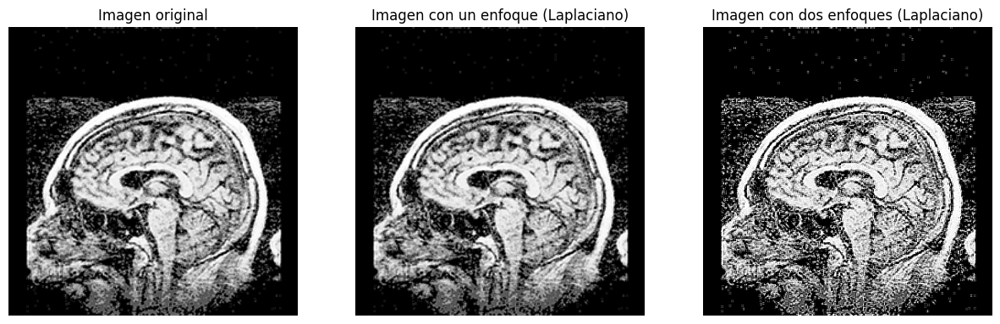

Imagen con dos enfoques guardada: /content/corte_64_doble_enfoque_1.png


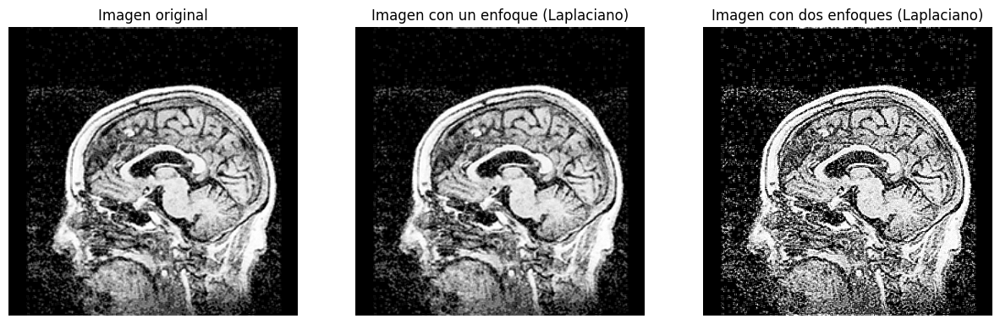

Imagen con dos enfoques guardada: /content/corte_64_doble_enfoque_3.png


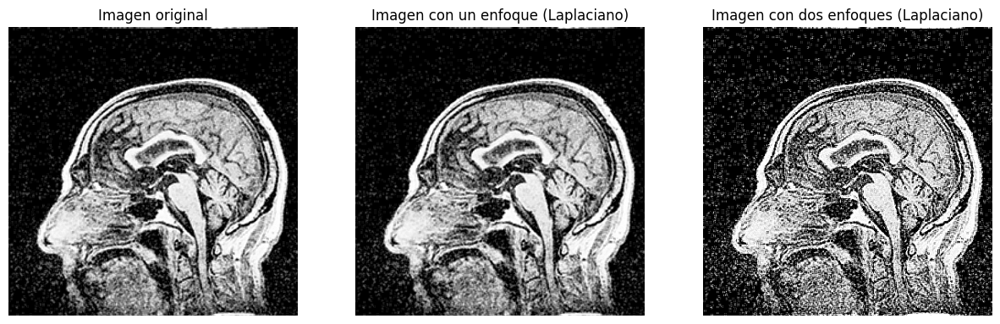

Imagen con dos enfoques guardada: /content/corte_64_doble_enfoque_4.png


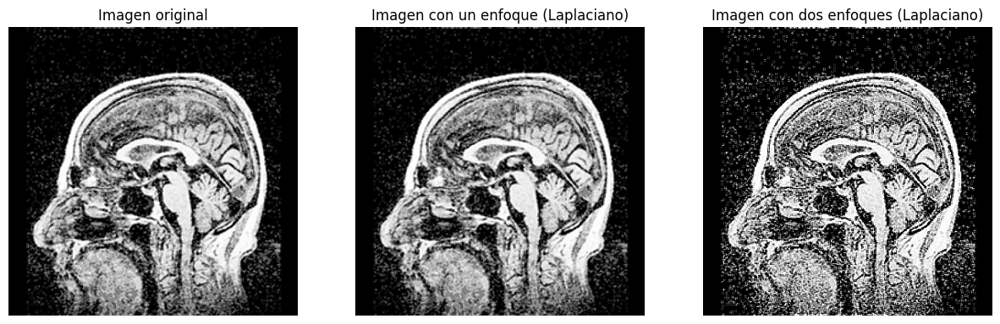

Imagen con dos enfoques guardada: /content/corte_64_doble_enfoque_2.png


In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import glob

# Ruta de las imágenes enfocadas con un filtro Laplaciano (de la iteración anterior)
enfocada_image_paths = glob.glob('/content/corte_64_enfocada_laplaciano_*.png')

# Función de convolución ya definida (usada para la aplicación de la máscara)
def convolucion(imagen, kernel):
    alto, ancho = imagen.shape
    kAlto, kAncho = kernel.shape
    paddingAlto, paddingAncho = kAlto // 2, kAncho // 2
    imagenPadded = np.pad(imagen, ((paddingAlto, paddingAlto), (paddingAncho, paddingAncho)), mode='constant')
    salida = np.zeros((alto, ancho))

    for i in range(alto):
        for j in range(ancho):
            region = imagenPadded[i:i + kAlto, j:j + kAncho]
            salida[i, j] = np.sum(region * kernel)

    return np.clip(salida, 0, 255).astype(np.uint8)

# Definir la máscara Laplaciana para el enfoque
kernelLaplaciano = np.array([[0, -1, 0],
                              [-1, 5, -1],
                              [0, -1, 0]])

# Procesar cada imagen enfocada
for path in enfocada_image_paths:
    imagen = Image.open(path)
    array = np.array(imagen)

    # Aplicar el filtro de enfoque (Laplaciano) por segunda vez
    imagenEnfocada2 = convolucion(array, kernelLaplaciano)

    # Mostrar las imágenes originales y las imágenes con un y dos enfoques
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(array, cmap='gray')
    ax[0].set_title("Imagen original")
    ax[1].imshow(imagen, cmap='gray')
    ax[1].set_title("Imagen con un enfoque (Laplaciano)")
    ax[2].imshow(imagenEnfocada2, cmap='gray')
    ax[2].set_title("Imagen con dos enfoques (Laplaciano)")

    for a in ax:
        a.axis('off')
    plt.show()

    # Guardar la imagen con dos enfoques
    path_enfocada2 = path.replace("enfocada_laplaciano", "doble_enfoque")
    Image.fromarray(imagenEnfocada2).save(path_enfocada2)

    print(f'Imagen con dos enfoques guardada: {path_enfocada2}')


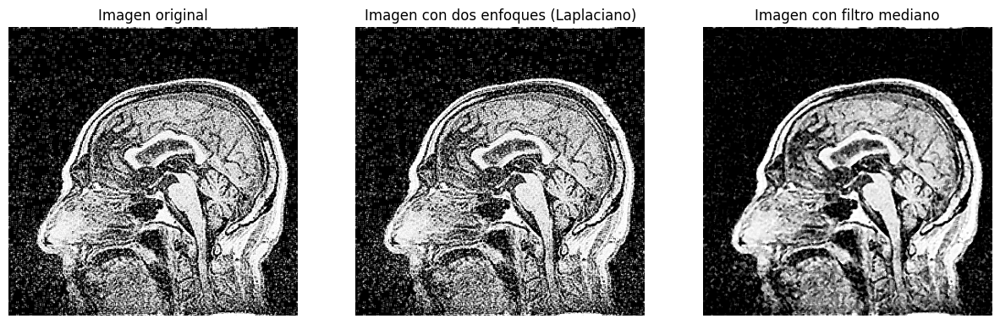

Imagen con filtro mediano guardada: /content/corte_64_doble_enfoque_4.png


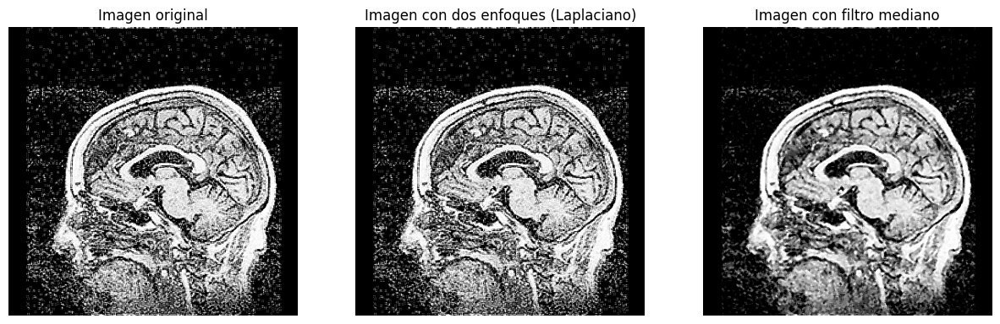

Imagen con filtro mediano guardada: /content/corte_64_doble_enfoque_3.png


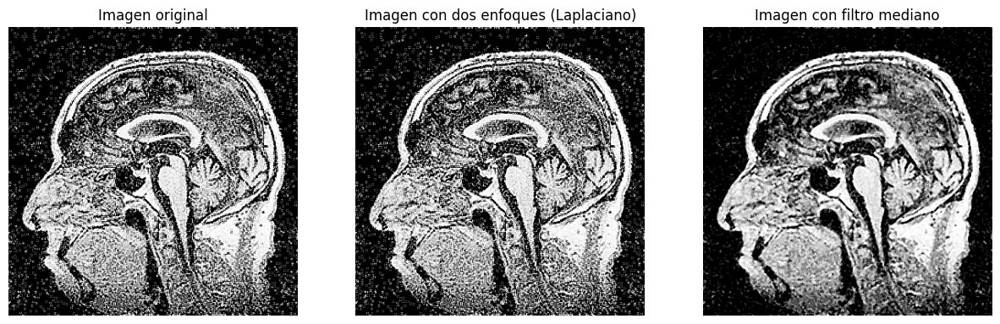

Imagen con filtro mediano guardada: /content/corte_64_doble_enfoque_5.png


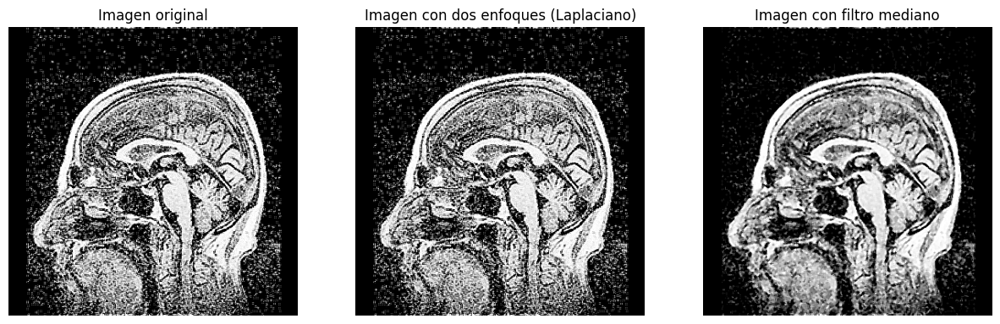

Imagen con filtro mediano guardada: /content/corte_64_doble_enfoque_2.png


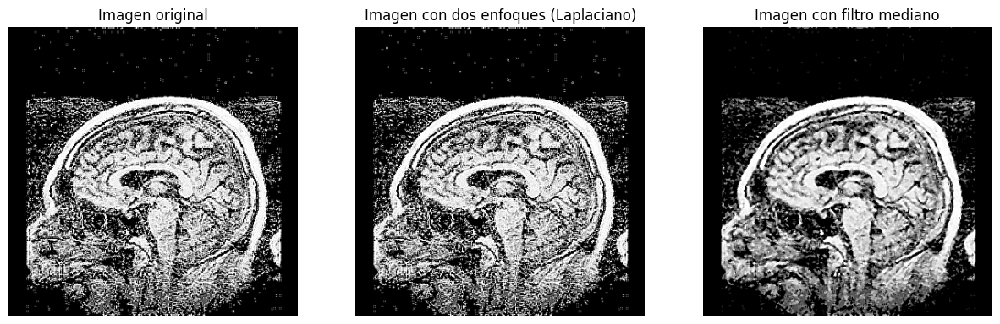

Imagen con filtro mediano guardada: /content/corte_64_doble_enfoque_1.png


In [ ]:
import numpy as np
from PIL import Image
from scipy.ndimage import median_filter
import matplotlib.pyplot as plt
import glob

# Ruta de las imágenes con el segundo enfoque aplicado
enfocada2_image_paths = glob.glob('/content/corte_64_doble_enfoque_*.png')

# Procesar cada imagen con el filtro mediano
for path in enfocada2_image_paths:
    imagen = Image.open(path)
    array = np.array(imagen)

    # Aplicar el filtro mediano con un kernel de 3x3
    imagen_filtrada = median_filter(array, size=3)

    # Mostrar las imágenes originales, con dos enfoques y con el filtro mediano aplicado
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(array, cmap='gray')
    ax[0].set_title("Imagen original")
    ax[1].imshow(imagen, cmap='gray')
    ax[1].set_title("Imagen con dos enfoques (Laplaciano)")
    ax[2].imshow(imagen_filtrada, cmap='gray')
    ax[2].set_title("Imagen con filtro mediano")

    for a in ax:
        a.axis('off')
    plt.show()

    # Guardar la imagen con filtro mediano
    path_filtrada = path.replace("enfocada_laplaciano_2", "enfocada_laplaciano_2_filtrada")
    Image.fromarray(imagen_filtrada).save(path_filtrada)

    print(f'Imagen con filtro mediano guardada: {path_filtrada}')


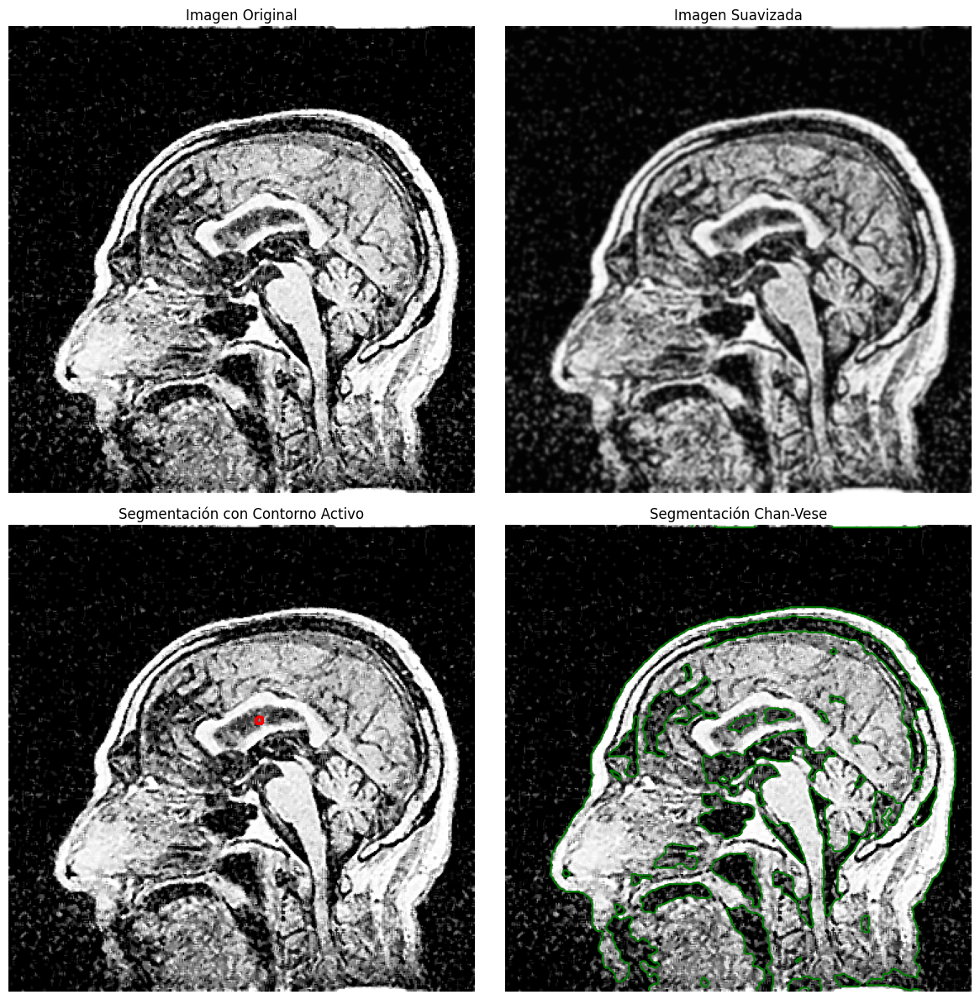

Máscara guardada: /content/corte_64_mask_snake_4.png


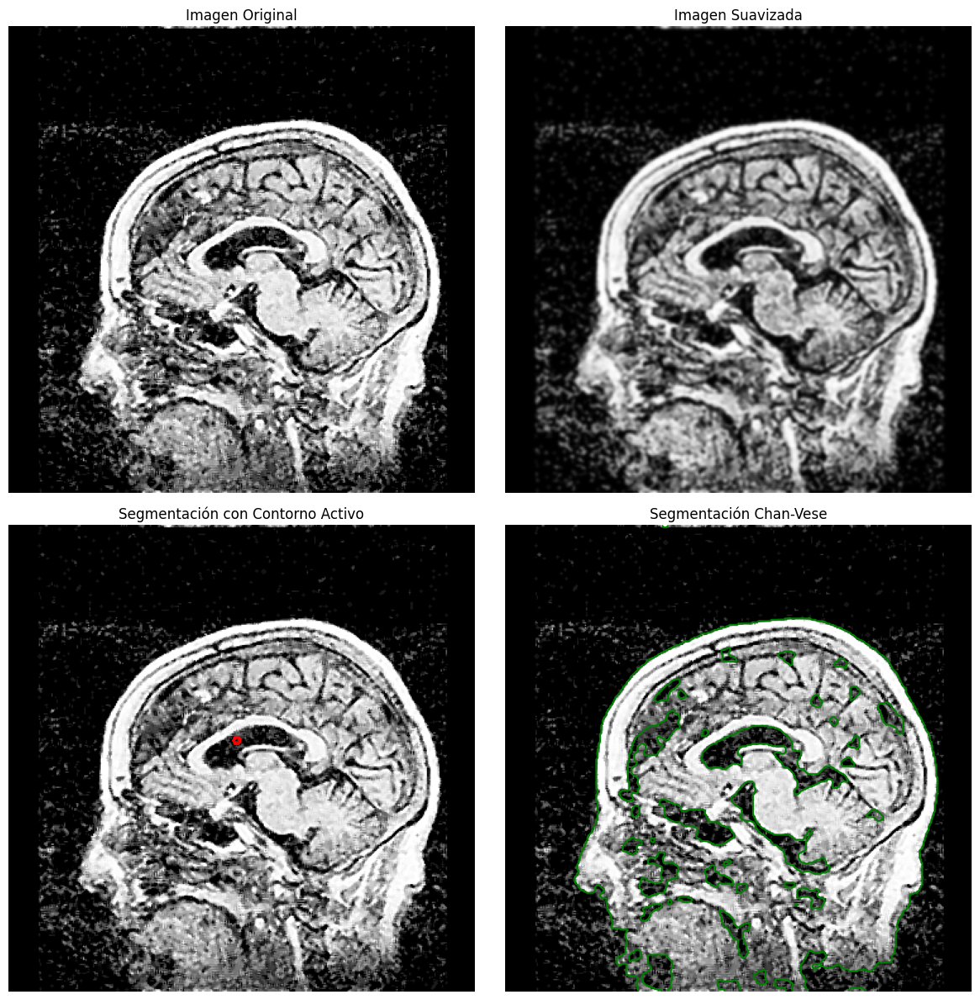

Máscara guardada: /content/corte_64_mask_snake_3.png


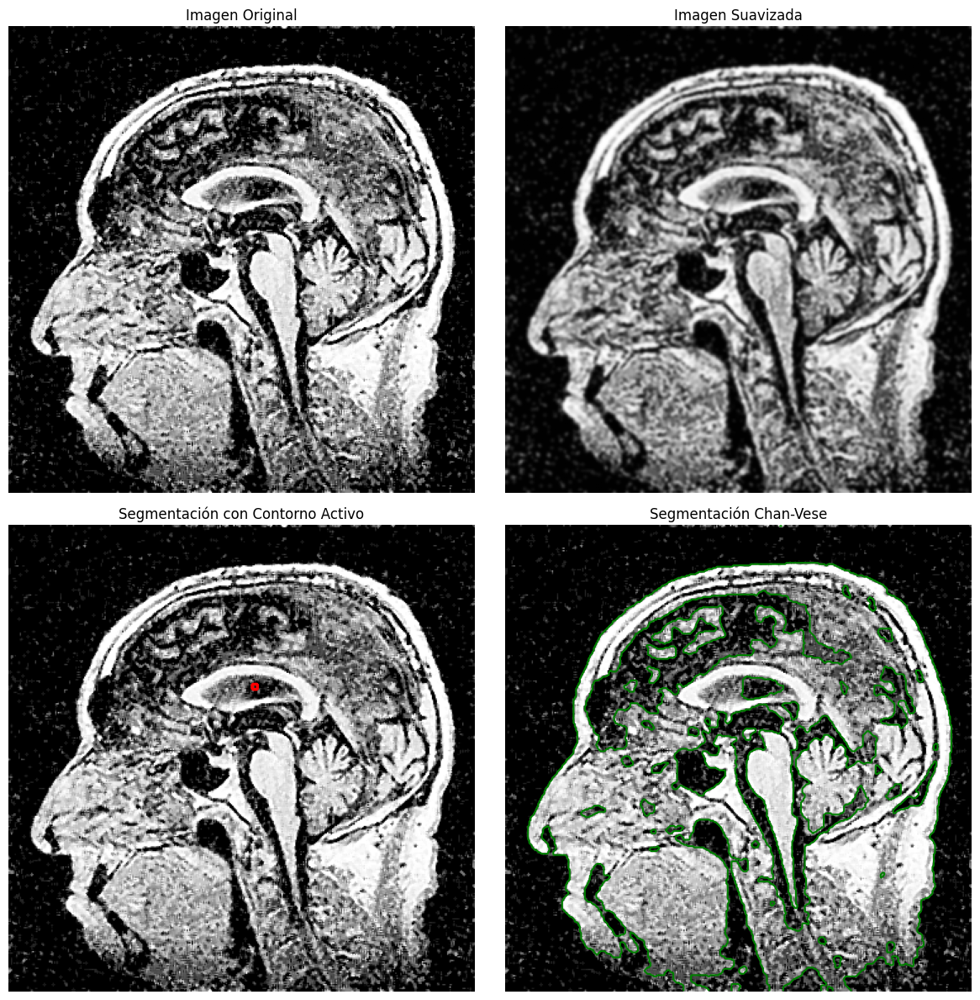

Máscara guardada: /content/corte_64_mask_snake_5.png


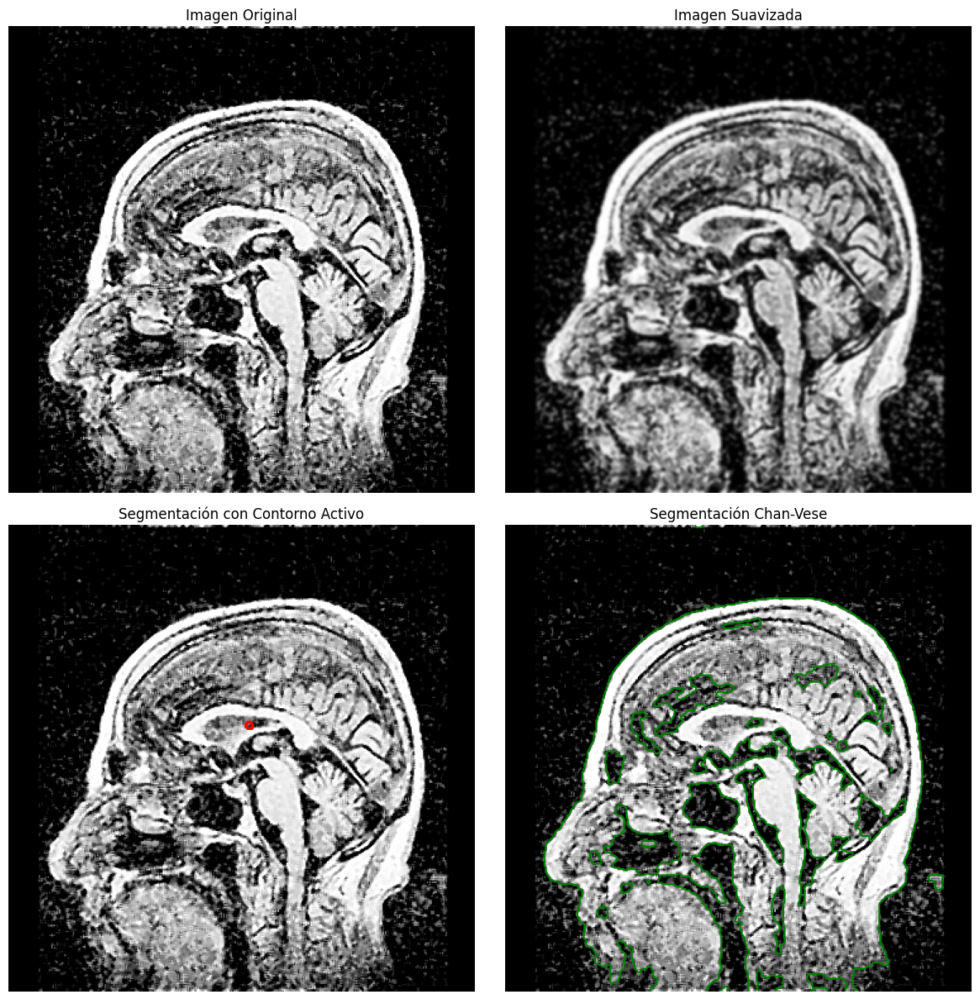

Máscara guardada: /content/corte_64_mask_snake_2.png


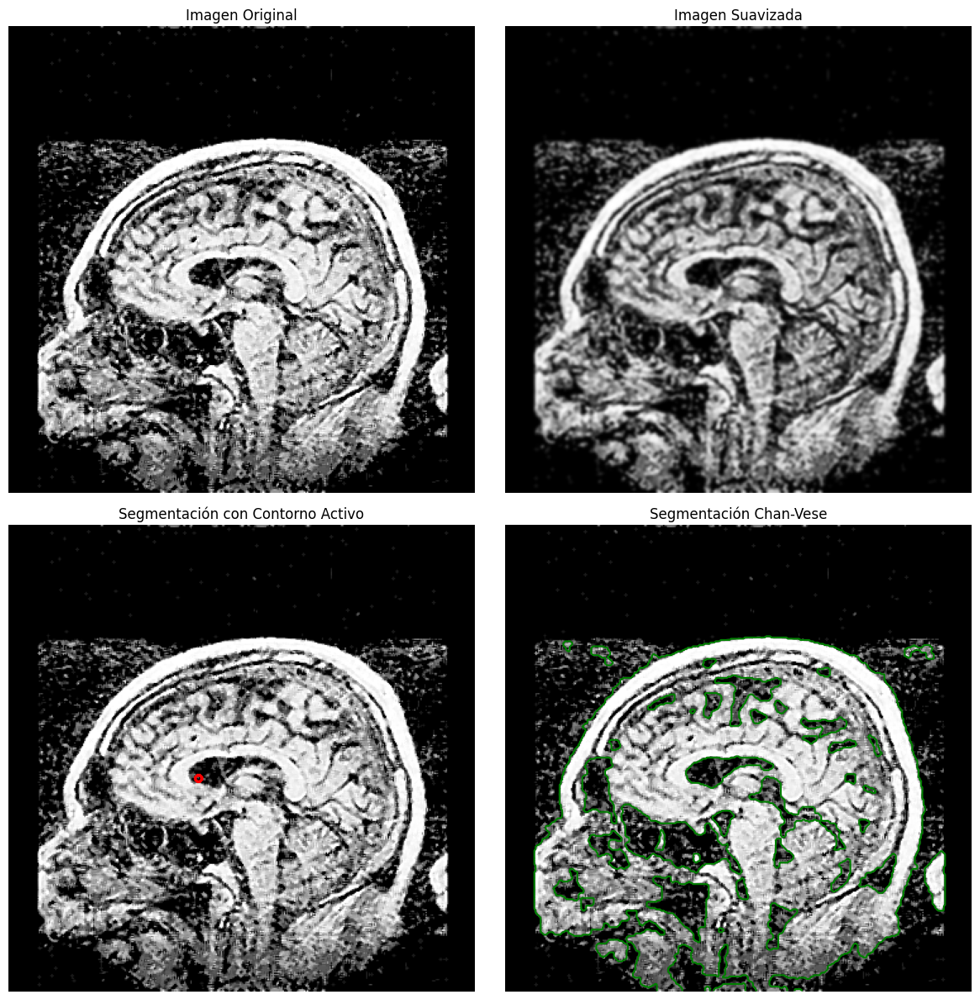

Máscara guardada: /content/corte_64_mask_snake_1.png


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters, exposure, segmentation, measure, morphology
from skimage.draw import polygon
from scipy.ndimage import gaussian_filter
from skimage.segmentation import active_contour
from PIL import Image
import glob
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters, exposure, segmentation, measure, morphology
from skimage.draw import polygon
from scipy.ndimage import gaussian_filter
from skimage.segmentation import active_contour
from PIL import Image
import glob

# Función para segmentar el hipocampo
def segment_hippocampus_anatomic(imagen):
    # Normalizar y mejorar contraste
    imagen_norm = exposure.rescale_intensity(imagen, out_range=(0, 1))
    imagen_norm = exposure.equalize_adapthist(imagen_norm, clip_limit=0.03)

    # Aplicar filtro gaussiano para suavizar la imagen
    imagen_suavizada = gaussian_filter(imagen_norm, sigma=1.0)

    # Usar un umbral más restrictivo para aislar áreas de mayor densidad
    umbral_hipocampo = np.percentile(imagen_suavizada, 90)
    imagen_umbralizada = imagen_suavizada > umbral_hipocampo

    # Aplicar morfología para limpiar pequeñas áreas no deseadas
    imagen_limpia = morphology.remove_small_objects(imagen_umbralizada, min_size=1000)

    # Detectar bordes usando el filtro de Scharr
    edges = filters.scharr(imagen_limpia)

    # Estimación anatómica del hipocampo: cuadrante superior derecho o izquierdo
    altura, ancho = imagen.shape
    mask_anatomica = np.zeros_like(imagen_limpia)

    # Limitar la búsqueda a la mitad superior y áreas laterales
    mask_anatomica[int(altura * 0.3):int(altura * 0.7), int(ancho * 0.2):int(ancho * 0.8)] = imagen_limpia[
        int(altura * 0.3):int(altura * 0.7), int(ancho * 0.2):int(ancho * 0.8)]

    # Crear un contorno inicial dentro de la región anatómica
    etiquetas = measure.label(mask_anatomica)
    regiones = measure.regionprops(etiquetas)

    if regiones:
        region_central = max(regiones, key=lambda r: r.area)  # Selección de la región más grande
        minr, minc, maxr, maxc = region_central.bbox
        r = (maxr - minr) // 4  # Radio basado en la región
        center_y, center_x = region_central.centroid
    else:
        center_y, center_x, r = altura // 2, ancho // 2, 20

    # Crear contorno inicial basado en la anatomía
    t = np.linspace(0, 2 * np.pi, 100)
    x = center_x + r * np.cos(t)
    y = center_y + r * np.sin(t)
    init = np.array([x, y]).T

    # Aplicar contorno activo (snake)
    snake = active_contour(edges, init, alpha=0.02, beta=15, gamma=0.01)

    # Crear máscara final del snake
    mask_snake = np.zeros_like(imagen_norm)
    snake_y = np.round(snake[:, 1]).astype(int)
    snake_x = np.round(snake[:, 0]).astype(int)
    snake_y = np.clip(snake_y, 0, mask_snake.shape[0] - 1)
    snake_x = np.clip(snake_x, 0, mask_snake.shape[1] - 1)

    rr, cc = polygon(snake_y, snake_x)
    mask_snake[rr, cc] = 1

    # Segmentación Chan-Vese como respaldo
    cv_mask = segmentation.chan_vese(imagen_suavizada, mu=0.3, lambda1=1, lambda2=1, tol=1e-3, dt=0.5)

    return imagen_norm, imagen_suavizada, mask_snake, cv_mask

# Función para segmentar el hipocampo
def segment_hippocampus_anatomic1(imagen, cord_x, cord_y):
    # Normalizar y mejorar contraste
    imagen_norm = exposure.rescale_intensity(imagen, out_range=(0, 1))
    imagen_norm = exposure.equalize_adapthist(imagen_norm, clip_limit=0.03)

    # Aplicar filtro gaussiano para suavizar la imagen
    imagen_suavizada = gaussian_filter(imagen_norm, sigma=1.0)

    # Usar un umbral más restrictivo para aislar áreas de mayor densidad
    umbral_hipocampo = np.percentile(imagen_suavizada, 90)
    imagen_umbralizada = imagen_suavizada > umbral_hipocampo

    # Aplicar morfología para limpiar pequeñas áreas no deseadas
    imagen_limpia = morphology.remove_small_objects(imagen_umbralizada, min_size=1000)

    # Detectar bordes usando el filtro de Scharr
    edges = filters.scharr(imagen_limpia)

    # Estimación anatómica del hipocampo: cuadrante superior derecho o izquierdo
    altura, ancho = imagen.shape
    mask_anatomica = np.zeros_like(imagen_limpia)

    # Limitar la búsqueda a la mitad superior y áreas laterales
    mask_anatomica[int(altura * 0.3):int(altura * 0.7), int(ancho * 0.2):int(ancho * 0.8)] = imagen_limpia[
        int(altura * 0.3):int(altura * 0.7), int(ancho * 0.2):int(ancho * 0.8)]

    # Crear un contorno inicial dentro de la región anatómica
    etiquetas = measure.label(mask_anatomica)
    regiones = measure.regionprops(etiquetas)

    if regiones:
        region_central = max(regiones, key=lambda r: r.area)  # Selección de la región más grande
        minr, minc, maxr, maxc = region_central.bbox
        r = (maxr - minr) // 4  # Radio basado en la región
        center_y, center_x = region_central.centroid
    else:
        center_y, center_x, r = altura // 2, ancho // 2, 20

    # Crear contorno inicial basado en la anatomía
    t = np.linspace(0, 2 * np.pi, 100)
    center_x, center_y = cord_x, cord_y
    x = center_x + r * np.cos(t)
    y = center_y + r * np.sin(t)
    init = np.array([x, y]).T

    # Aplicar contorno activo (snake)
    snake = active_contour(edges, init, alpha=0.02, beta=15, gamma=0.01)

    # Crear máscara final del snake
    mask_snake = np.zeros_like(imagen_norm)
    snake_y = np.round(snake[:, 1]).astype(int)
    snake_x = np.round(snake[:, 0]).astype(int)
    snake_y = np.clip(snake_y, 0, mask_snake.shape[0] - 1)
    snake_x = np.clip(snake_x, 0, mask_snake.shape[1] - 1)

    rr, cc = polygon(snake_y, snake_x)
    mask_snake[rr, cc] = 1

    # Segmentación Chan-Vese como respaldo
    cv_mask = segmentation.chan_vese(imagen_suavizada, mu=0.3, lambda1=1, lambda2=1, tol=1e-3, dt=0.5)

    return imagen_norm, imagen_suavizada, mask_snake, cv_mask

# Función para visualizar los resultados
def visualizar_resultados(imagen_original, imagen_suavizada, mask_snake, mask_cv):
    fig, axes = plt.subplots(2, 2, figsize=(12, 12))

    axes[0, 0].imshow(imagen_original, cmap='gray')
    axes[0, 0].set_title('Imagen Original')
    axes[0, 0].axis('off')

    axes[0, 1].imshow(imagen_suavizada, cmap='gray')
    axes[0, 1].set_title('Imagen Suavizada')
    axes[0, 1].axis('off')

    axes[1, 0].imshow(imagen_original, cmap='gray')
    axes[1, 0].contour(mask_snake, colors='r')
    axes[1, 0].set_title('Segmentación con Contorno Activo')
    axes[1, 0].axis('off')

    axes[1, 1].imshow(imagen_original, cmap='gray')
    axes[1, 1].contour(mask_cv, colors='g')
    axes[1, 1].set_title('Segmentación Chan-Vese')
    axes[1, 1].axis('off')

    plt.tight_layout()
    plt.show()

# Ruta de las imágenes filtradas con el filtro mediano
filtradas_image_paths = glob.glob('/content/corte_64_doble_enfoque_*.png')

# Procesar cada imagen filtrada
for path in filtradas_image_paths:

    if path == '/content/corte_64_doble_enfoque_3.png':
        imagen = Image.open(path)
        array = np.array(imagen)

        # Ejecutar la segmentación
        imagen_norm, imagen_suavizada, mask_snake, mask_cv = segment_hippocampus_anatomic1(array, 180, 170)

        # Visualizar los resultados
        visualizar_resultados(array, imagen_suavizada, mask_snake, mask_cv)

        # Guardar las máscaras de segmentación (si es necesario)
        path_mask_snake = path.replace("doble_enfoque", "mask_snake")

        Image.fromarray((mask_snake * 255).astype(np.uint8)).save(path_mask_snake)

        print(f'Máscara guardada: {path_mask_snake}')
    elif path == '/content/corte_64_doble_enfoque_1.png':
        imagen = Image.open(path)
        array = np.array(imagen)

        # Ejecutar la segmentación
        imagen_norm, imagen_suavizada, mask_snake, mask_cv = segment_hippocampus_anatomic1(array, 150, 200)

        # Visualizar los resultados
        visualizar_resultados(array, imagen_suavizada, mask_snake, mask_cv)

        # Guardar las máscaras de segmentación (si es necesario)
        path_mask_snake = path.replace("doble_enfoque", "mask_snake")

        Image.fromarray((mask_snake * 255).astype(np.uint8)).save(path_mask_snake)

        print(f'Máscara guardada: {path_mask_snake}')

    else:
        imagen = Image.open(path)
        array = np.array(imagen)

        # Ejecutar la segmentación
        imagen_norm, imagen_suavizada, mask_snake, mask_cv = segment_hippocampus_anatomic(array)

        # Visualizar los resultados
        visualizar_resultados(array, imagen_suavizada, mask_snake, mask_cv)

        # Guardar las máscaras de segmentación (si es necesario)
        path_mask_snake = path.replace("doble_enfoque", "mask_snake")

        Image.fromarray((mask_snake * 255).astype(np.uint8)).save(path_mask_snake)

        print(f'Máscara guardada: {path_mask_snake}')

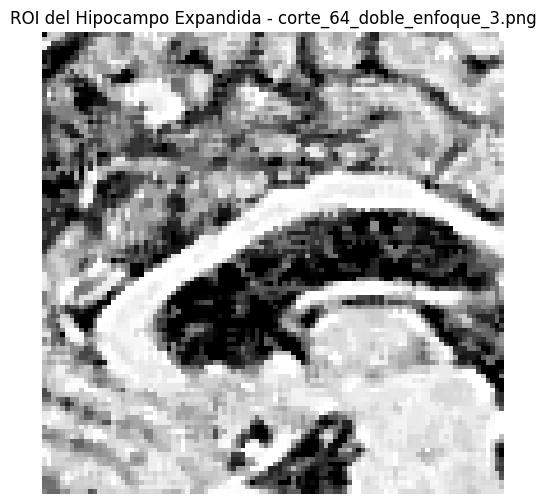

ROI guardada: /content/corte_64_hippocampus_roi_3.png


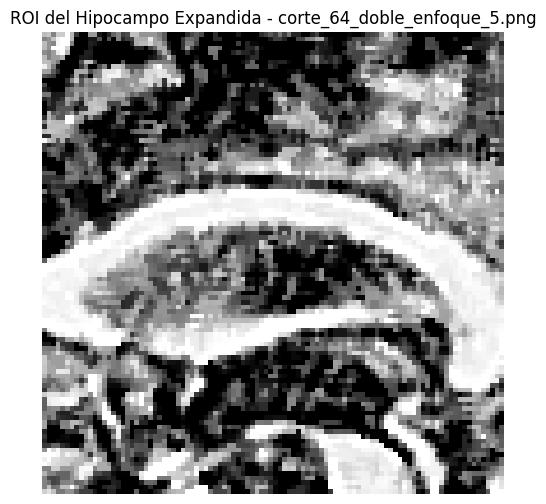

ROI guardada: /content/corte_64_hippocampus_roi_5.png


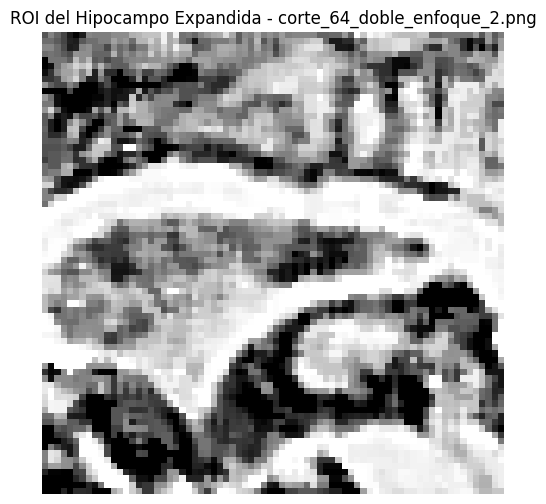

ROI guardada: /content/corte_64_hippocampus_roi_2.png


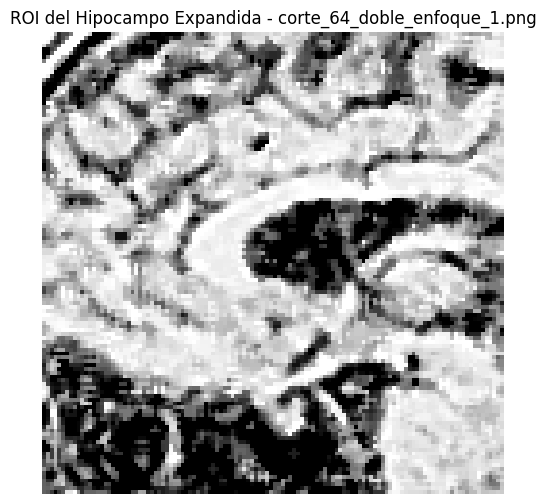

ROI guardada: /content/corte_64_hippocampus_roi_1.png


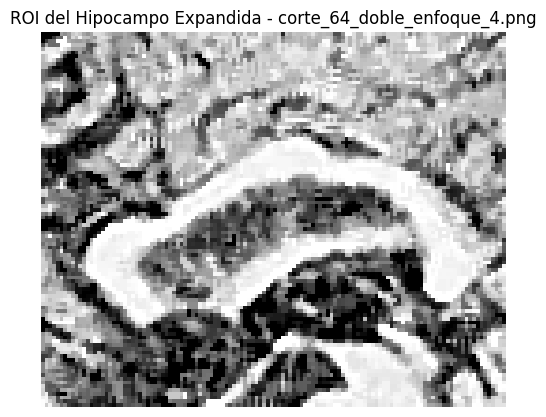

ROI guardada: /content/corte_64_hippocampus_roi_4.png


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import glob

# Función para extraer la región de interés (ROI) del hipocampo
def extract_hippocampus_roi(imagen, mask_snake, expansion_factor=1.5):
    # Encontrar las coordenadas del bounding box del contorno activo
    coords = np.argwhere(mask_snake)
    min_y, min_x = coords.min(axis=0)
    max_y, max_x = coords.max(axis=0)

    # Calcular el centro del bounding box
    center_y = (min_y + max_y) // 2
    center_x = (min_x + max_x) // 2

    # Calcular las nuevas dimensiones expandiendo la región
    height = (max_y - min_y) * expansion_factor
    width = (max_x - min_x) * expansion_factor
    new_min_y = max(int(center_y - height // 2), 0)
    new_max_y = min(int(center_y + height // 2), imagen.shape[0])
    new_min_x = max(int(center_x - width // 2), 0)
    new_max_x = min(int(center_x + width // 2), imagen.shape[1])

    # Extraer la ROI expandida
    roi = imagen[new_min_y:new_max_y, new_min_x:new_max_x]

    return roi

# Ruta de las imágenes filtradas con el filtro mediano
filtradas_image_paths = glob.glob('/content/corte_64_doble_enfoque_*.png')

# Procesar cada imagen filtrada
for path in filtradas_image_paths:
    if path == '/content/corte_64_doble_enfoque_3.png':
      imagen = Image.open(path)
      array = np.array(imagen)

      # Ejecutar la segmentación (obtención de mask_snake)
      imagen_norm, imagen_suavizada, mask_snake, mask_cv = segment_hippocampus_anatomic1(array, 180, 170)

      # Extraer la ROI del hipocampo utilizando la máscara del contorno activo
      hippocampus_roi = extract_hippocampus_roi(array, mask_snake, expansion_factor=25)

      # Mostrar la ROI extraída
      plt.figure(figsize=(6, 6))
      plt.title(f"ROI del Hipocampo Expandida - {path.split('/')[-1]}")
      plt.imshow(hippocampus_roi, cmap='gray')
      plt.axis('off')
      plt.show()

      # Guardar la ROI extraída como una imagen
      path_roi = path.replace("doble_enfoque", "hippocampus_roi")
      Image.fromarray(hippocampus_roi).save(path_roi)

      print(f"ROI guardada: {path_roi}")

    elif path == '/content/corte_64_doble_enfoque_1.png':
      imagen = Image.open(path)
      array = np.array(imagen)

      # Ejecutar la segmentación (obtención de mask_snake)
      imagen_norm, imagen_suavizada, mask_snake, mask_cv = segment_hippocampus_anatomic1(array, 150, 200)

      # Extraer la ROI del hipocampo utilizando la máscara del contorno activo
      hippocampus_roi = extract_hippocampus_roi(array, mask_snake, expansion_factor=30)

      # Mostrar la ROI extraída
      plt.figure(figsize=(6, 6))
      plt.title(f"ROI del Hipocampo Expandida - {path.split('/')[-1]}")
      plt.imshow(hippocampus_roi, cmap='gray')
      plt.axis('off')
      plt.show()

      # Guardar la ROI extraída como una imagen
      path_roi = path.replace("doble_enfoque", "hippocampus_roi")
      Image.fromarray(hippocampus_roi).save(path_roi)

      print(f"ROI guardada: {path_roi}")

    else:
      imagen = Image.open(path)
      array = np.array(imagen)

      # Ejecutar la segmentación (obtención de mask_snake)
      imagen_norm, imagen_suavizada, mask_snake, mask_cv = segment_hippocampus_anatomic(array)

      # Extraer la ROI del hipocampo utilizando la máscara del contorno activo
      hippocampus_roi = extract_hippocampus_roi(array, mask_snake, expansion_factor=25)

      # Mostrar la ROI extraída
      plt.figure(figsize=(6, 6))
      plt.title(f"ROI del Hipocampo Expandida - {path.split('/')[-1]}")
      plt.imshow(hippocampus_roi, cmap='gray')
      plt.axis('off')
      plt.show()

      # Guardar la ROI extraída como una imagen
      path_roi = path.replace("doble_enfoque", "hippocampus_roi")
      Image.fromarray(hippocampus_roi).save(path_roi)

      print(f"ROI guardada: {path_roi}")

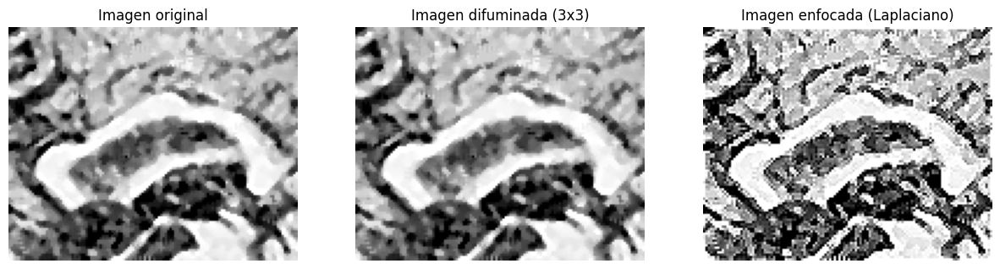

Imagen enfocada guardada: /content/corte_64_enfoque_laplace_hipo_4.png


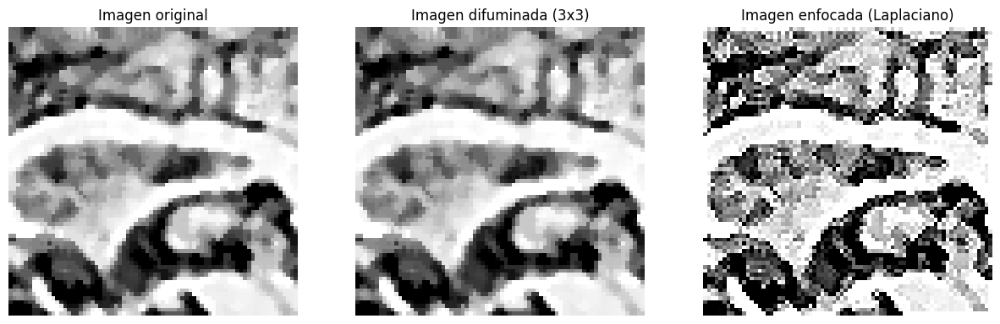

Imagen enfocada guardada: /content/corte_64_enfoque_laplace_hipo_2.png


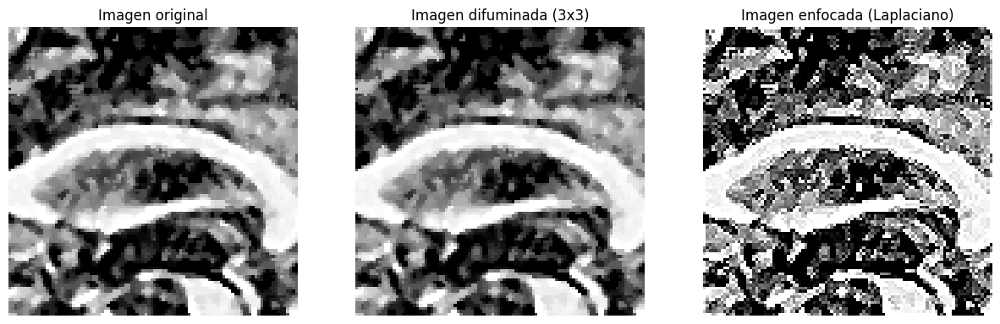

Imagen enfocada guardada: /content/corte_64_enfoque_laplace_hipo_5.png


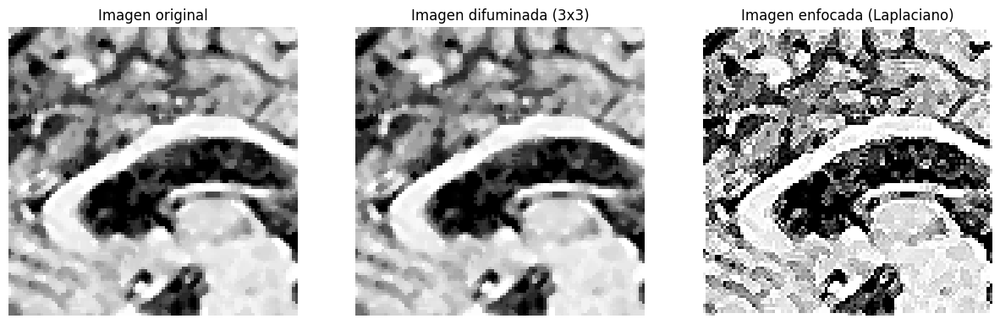

Imagen enfocada guardada: /content/corte_64_enfoque_laplace_hipo_3.png


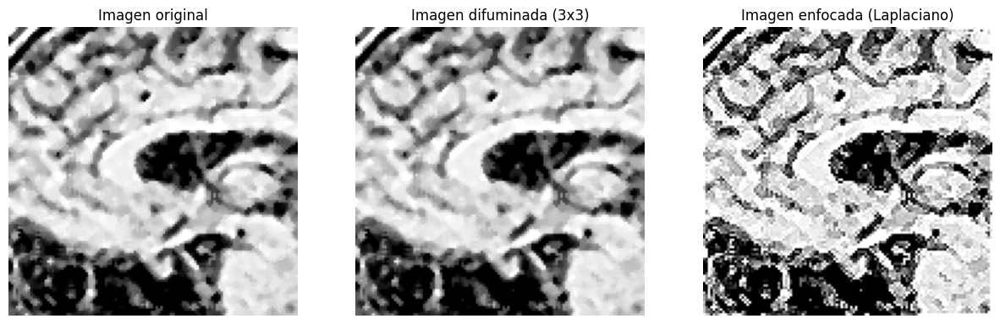

Imagen enfocada guardada: /content/corte_64_enfoque_laplace_hipo_1.png


In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import glob

# Ruta de las imágenes
roi_image_paths = glob.glob('/content/corte_64_hippocampus_median_*.png')

# Definir la máscara Laplaciana para el enfoque
kernelLaplaciano = np.array([[0, -1, 0],
                              [-1, 5, -1],
                              [0, -1, 0]])

# Función de convolución ya definida (usada para la aplicación de la máscara)
def convolucion(imagen, kernel):
    alto, ancho = imagen.shape
    kAlto, kAncho = kernel.shape
    paddingAlto, paddingAncho = kAlto // 2, kAncho // 2
    imagenPadded = np.pad(imagen, ((paddingAlto, paddingAlto), (paddingAncho, paddingAncho)), mode='constant')
    salida = np.zeros((alto, ancho))

    for i in range(alto):
        for j in range(ancho):
            region = imagenPadded[i:i + kAlto, j:j + kAncho]
            salida[i, j] = np.sum(region * kernel)

    return np.clip(salida, 0, 255).astype(np.uint8)

# Procesar cada imagen filtrada
for path in roi_image_paths:
    imagen = Image.open(path)
    array = np.array(imagen)

    # Aplicar el filtro de enfoque (Laplaciano)
    imagenEnfocada = convolucion(array, kernelLaplaciano)

    # Mostrar los resultados
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(array, cmap='gray')
    ax[0].set_title("Imagen original")
    ax[1].imshow(imagen, cmap='gray')
    ax[1].set_title("Imagen difuminada (3x3)")
    ax[2].imshow(imagenEnfocada, cmap='gray')
    ax[2].set_title("Imagen enfocada (Laplaciano)")

    for a in ax:
        a.axis('off')
    plt.show()

    # Guardar la imagen enfocada
    path_enfocada = path.replace("hippocampus_median", "enfoque_laplace_hipo")
    Image.fromarray(imagenEnfocada).save(path_enfocada)

    print(f'Imagen enfocada guardada: {path_enfocada}')

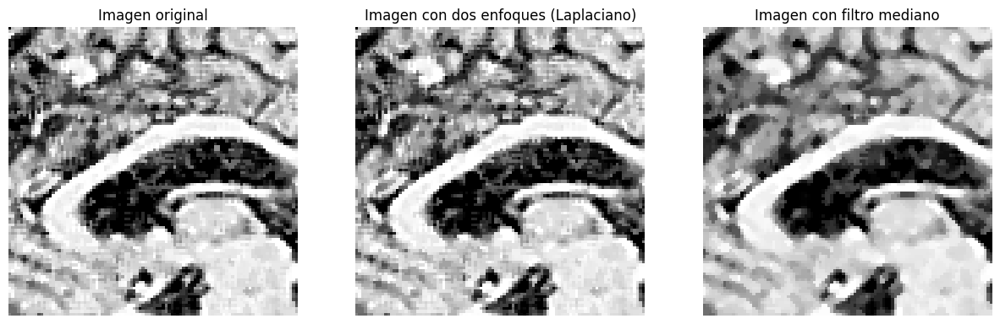

Imagen con filtro mediano guardada: /content/corte_64_hippocampus_median_3.png


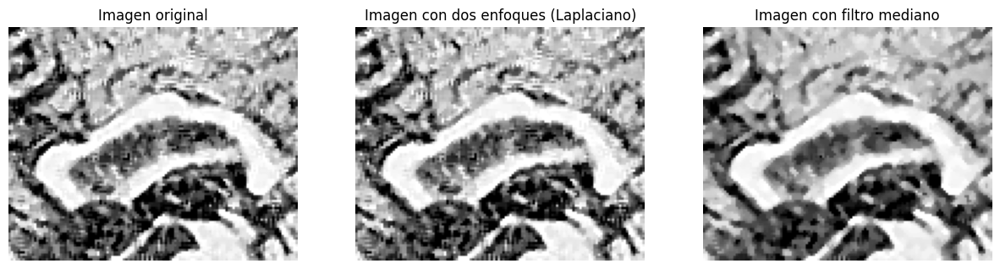

Imagen con filtro mediano guardada: /content/corte_64_hippocampus_median_4.png


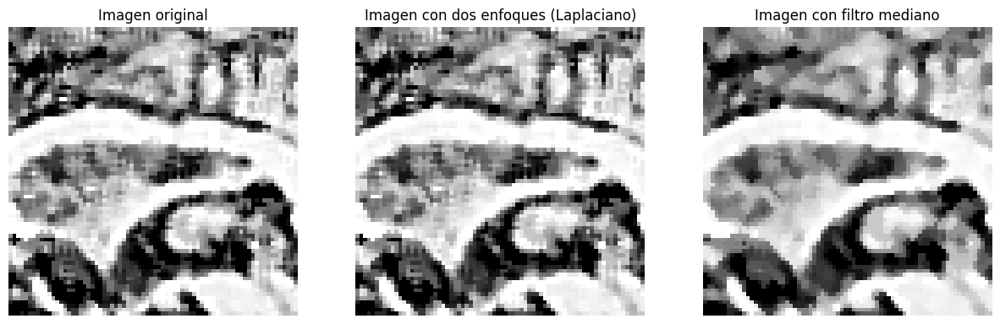

Imagen con filtro mediano guardada: /content/corte_64_hippocampus_median_2.png


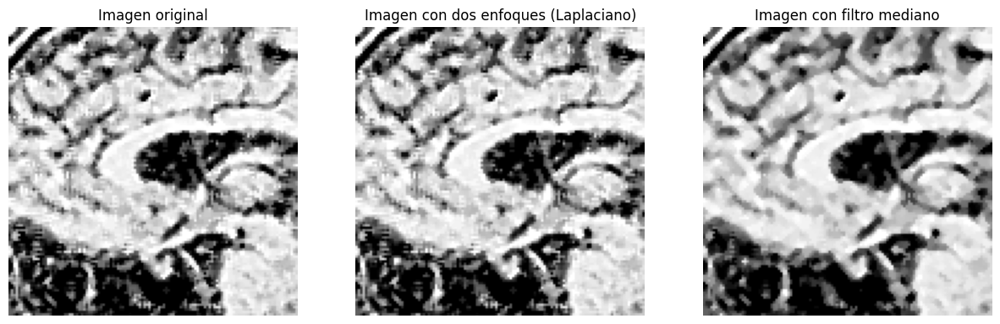

Imagen con filtro mediano guardada: /content/corte_64_hippocampus_median_1.png


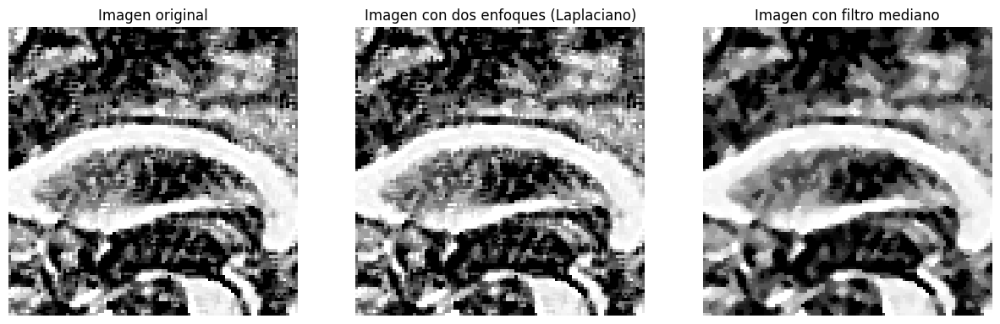

Imagen con filtro mediano guardada: /content/corte_64_hippocampus_median_5.png


In [ ]:
import numpy as np
from PIL import Image
from scipy.ndimage import median_filter
import matplotlib.pyplot as plt
import glob

# Ruta de las imágenes con el segundo enfoque aplicado
roi_image_paths = glob.glob('/content/corte_64_hippocampus_roi_*.png')

# Procesar cada imagen con el filtro mediano
for path in roi_image_paths:
    imagen = Image.open(path)
    array = np.array(imagen)

    # Aplicar el filtro mediano con un kernel de 3x3
    imagen_filtrada = median_filter(array, size=3)

    # Mostrar las imágenes originales, con dos enfoques y con el filtro mediano aplicado
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(array, cmap='gray')
    ax[0].set_title("Imagen original")
    ax[1].imshow(imagen, cmap='gray')
    ax[1].set_title("Imagen con dos enfoques (Laplaciano)")
    ax[2].imshow(imagen_filtrada, cmap='gray')
    ax[2].set_title("Imagen con filtro mediano")

    for a in ax:
        a.axis('off')
    plt.show()

    # Guardar la imagen con filtro mediano
    path_filtrada = path.replace("hippocampus_roi", "hippocampus_median")
    Image.fromarray(imagen_filtrada).save(path_filtrada)

    print(f'Imagen con filtro mediano guardada: {path_filtrada}')

Procesando /content/corte_64_hippocampus_roi_3.png...


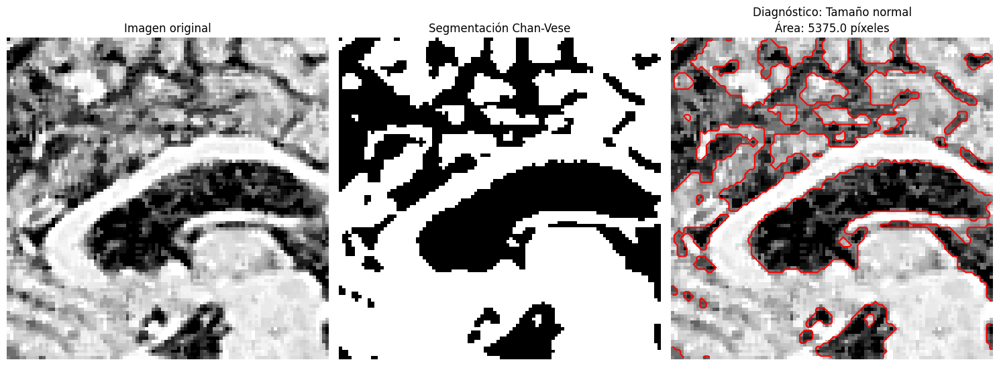

Procesando /content/corte_64_hippocampus_roi_4.png...


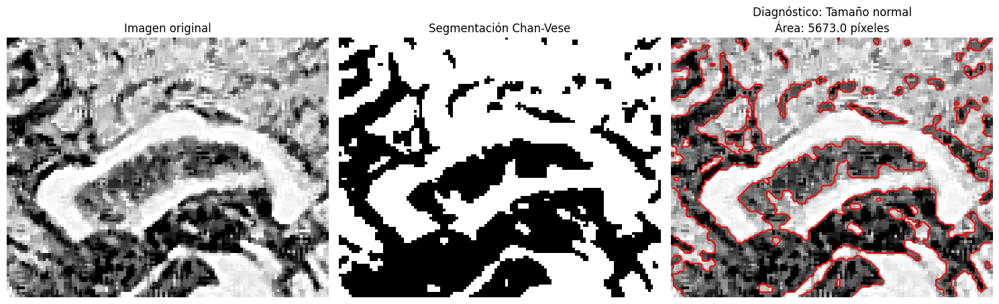

Procesando /content/corte_64_hippocampus_roi_2.png...


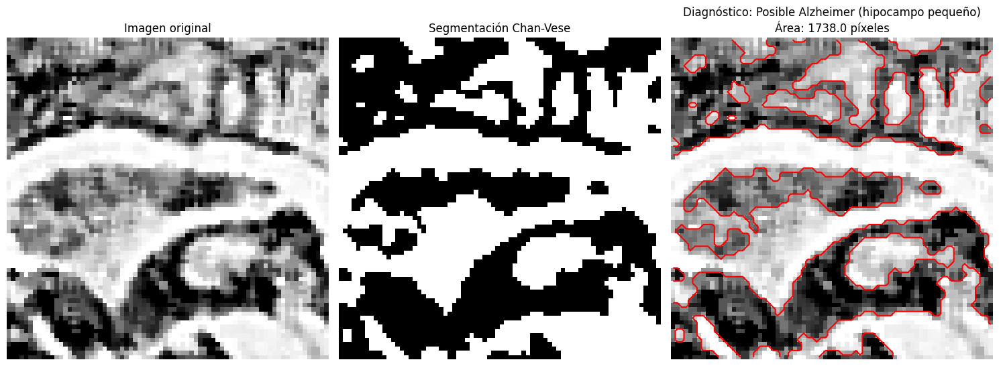

Procesando /content/corte_64_hippocampus_roi_1.png...


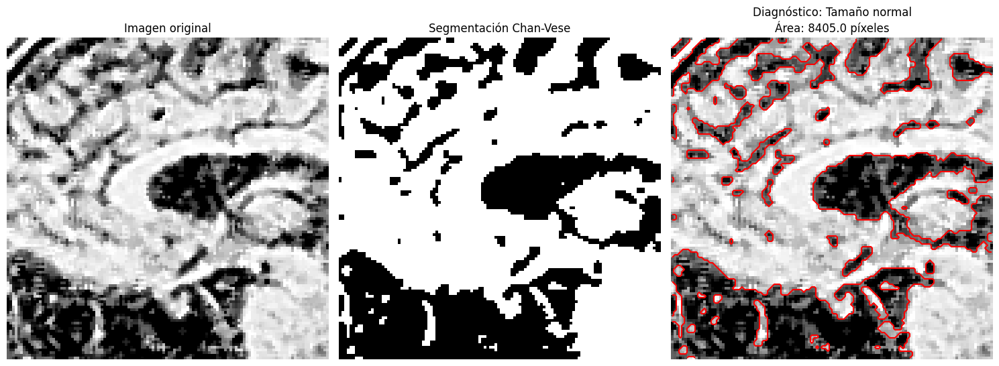

Procesando /content/corte_64_hippocampus_roi_5.png...


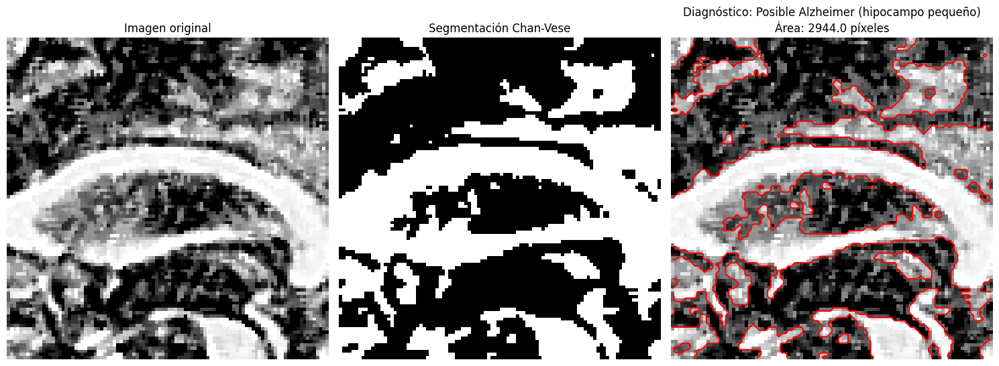

In [ ]:
from skimage.segmentation import chan_vese
from skimage.measure import label, regionprops
from skimage.filters import threshold_otsu
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import glob

# Definir un umbral para clasificar el tamaño del hipocampo
UMBRAL_AREA = 3000  # Ajusta este valor basado en los datos
roi_image_paths = glob.glob('/content/corte_64_hippocampus_roi_*.png')

# Procesar cada imagen ROI
for path in roi_image_paths:
    imagen = Image.open(path).convert('L')  # Convertir a escala de grises
    array = np.array(imagen)

    # Aplicar Chan-Vese para segmentar el hipocampo
    print(f"Procesando {path}...")
    segmentacion_chanvese = chan_vese(array, mu=0.1, lambda1=1, lambda2=1, tol=1e-3, max_num_iter=200)

    # Etiquetar regiones de la segmentación
    etiquetas = label(segmentacion_chanvese)
    propiedades = regionprops(etiquetas)

    # Calcular el área del hipocampo
    if propiedades:
        region_principal = max(propiedades, key=lambda x: x.area)
        area = region_principal.area
        diagnostico = "Posible Alzheimer (hipocampo pequeño)" if area < UMBRAL_AREA else "Tamaño normal"

        # Mostrar la imagen segmentada y el diagnóstico
        plt.figure(figsize=(15, 7))
        plt.subplot(1, 3, 1)
        plt.imshow(array, cmap='gray')
        plt.title("Imagen original")
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(segmentacion_chanvese, cmap='gray')
        plt.title("Segmentación Chan-Vese")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(array, cmap='gray')
        plt.contour(segmentacion_chanvese, colors='r')
        plt.title(f"Diagnóstico: {diagnostico}\nÁrea: {area} píxeles")
        plt.axis('off')

        plt.tight_layout()
        plt.show()
    else:
        print(f"No se detectaron regiones en {path}.")